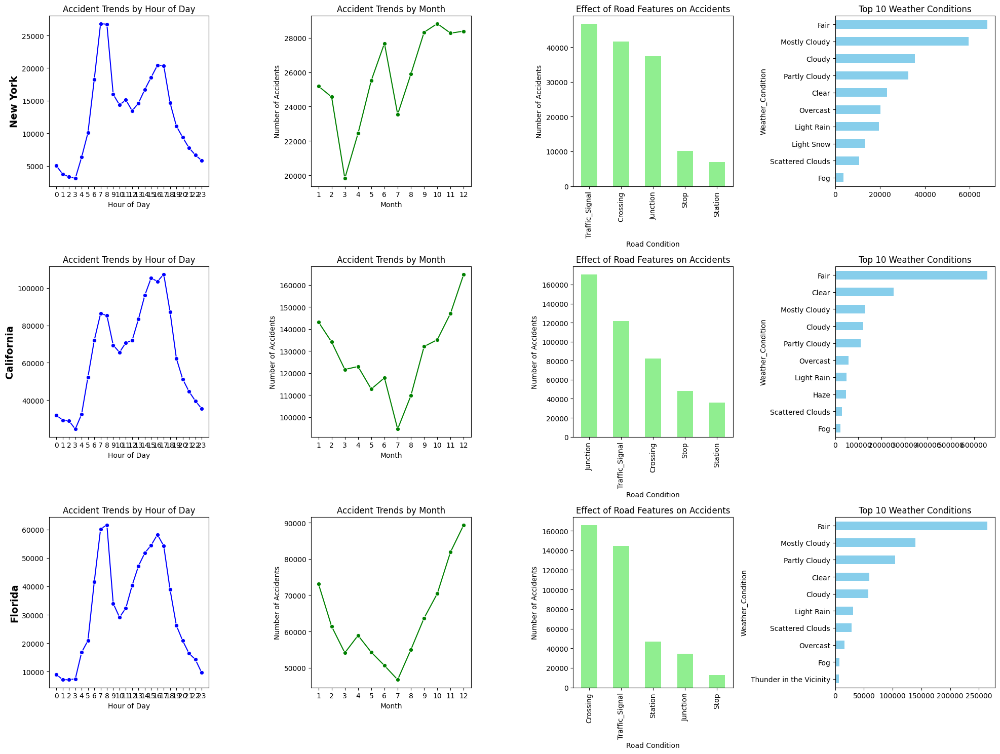

Heatmap saved: ../data/New York_heatmap.html


Heatmap saved: ../data/California_heatmap.html


Heatmap saved: ../data/Florida_heatmap.html


In [ ]:
import folium
from folium.plugins import HeatMap
import pandas as pd
import gdown
import os
import matplotlib.pyplot as plt
import seaborn as sns

def load_data(file_id):
    output_dir = "../data/all_data/"
    output_path = f"{output_dir}cleaned_ny_data_{file_id}.csv"

    # Download data if it does not exist
    if not os.path.exists(output_path):
        gdown.download(f"https://drive.google.com/uc?id={file_id}", output_path, quiet=False)

    df = pd.read_csv(output_path, sep=",", low_memory=False)

    # Convert Start_Time and End_Time to datetime
    df['Start_Time'] = pd.to_datetime(df['Start_Time'], errors='coerce')
    df['End_Time'] = pd.to_datetime(df['End_Time'], errors='coerce')

    # Drop rows where conversion failed
    df = df[df['Start_Time'].notna() & df['End_Time'].notna()]

    return df

# Modify all plotting functions to accept `ax` argument
def plot_accidents_by_severity(data, ax):
    data['Severity'].value_counts().plot(kind='bar', ax=ax)
    ax.set_title('Accidents by Severity')
    ax.set_xlabel('Severity')
    ax.set_ylabel('Number of Accidents')

def plot_accidents_by_city(data, ax):
    top_cities = data['City'].value_counts().head(20).sort_values()
    top_cities.plot(kind='barh', ax=ax)
    ax.set_title('Top 20 Cities With Most Accidents')
    ax.set_xlabel('Number of Accidents')
    ax.set_ylabel('City')

def plot_accidents_by_county(data, ax):
    top_counties = data['County'].value_counts().head(20).sort_values()
    top_counties.plot(kind='barh', ax=ax)
    ax.set_title('Top 20 Counties With Most Accidents')
    ax.set_xlabel('Number of Accidents')
    ax.set_ylabel('County')

def plot_accidents_by_category(data, ax, category_column='City', top_n=10):
    data = data.dropna(subset=['Start_Time'])
    data['hour'] = data['Start_Time'].dt.hour
    data['Day_Night'] = data['hour'].apply(lambda h: 'Day' if 6 <= h < 18 else 'Night')

    top_categories = data[category_column].value_counts().head(top_n).index
    df_top_categories = data[data[category_column].isin(top_categories)]

    order = df_top_categories[category_column].value_counts().index
    sns.countplot(data=df_top_categories, x=category_column, hue='Day_Night', order=order, ax=ax, palette='Blues')
    ax.set_title(f'Accidents by {category_column}: Day vs Night')

def plot_accidents_by_hour_of_day(data, ax):
    data['hour'] = data['Start_Time'].dt.hour
    hour_accidents = data['hour'].value_counts().sort_index()
    sns.lineplot(x=hour_accidents.index, y=hour_accidents.values, marker='o', color='b', ax=ax)
    ax.set_title('Accident Trends by Hour of Day')
    ax.set_xlabel('Hour of Day')
    ax.set_ylabel('Number of Accidents')
    ax.set_xticks(range(24))

def plot_accidents_by_month(data, ax):
    data['Month'] = data['Start_Time'].dt.month
    monthly_accidents = data['Month'].value_counts().sort_index()
    sns.lineplot(x=monthly_accidents.index, y=monthly_accidents.values, marker='o', color='g', ax=ax)
    ax.set_title('Accident Trends by Month')
    ax.set_xlabel('Month')
    ax.set_ylabel('Number of Accidents')
    ax.set_xticks(range(1, 13))

def plot_comparing_by_accident_by_road_condition(data, ax):
    road_features_all = ['Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit', 'Railway', 'Roundabout', 'Station', 'Stop', 'Traffic_Calming', 'Traffic_Signal']
    road_features = [feature for feature in road_features_all if feature in data.columns]

    road_impact = data[road_features].sum().sort_values(ascending=False).head(5)
    road_impact.plot(kind='bar', color='lightgreen', ax=ax)
    ax.set_title('Effect of Road Features on Accidents')
    ax.set_xlabel("Road Condition")
    ax.set_ylabel("Number of Accidents")

def plot_correlation_of_temperature(data, ax):
    temp_accidents = data.groupby('Temperature(F)').size()
    ax.scatter(temp_accidents.index, temp_accidents.values, color='blue', alpha=0.5)
    ax.set_title('Correlation between Temperature & Accidents')
    ax.set_xlabel('Temperature (°F)')
    ax.set_ylabel('Number of Accidents')

def plot_weather_condition(data, ax):
    weather_cond = data['Weather_Condition'].value_counts().head(10).sort_values()
    weather_cond.plot(kind='barh', color='skyblue', ax=ax)
    ax.set_title('Top 10 Weather Conditions')

def plot_temperature_distribution(data, ax):
    sns.boxplot(y=data['Temperature(F)'], ax=ax)
    ax.set_title('Temperature Distribution')

def plot_sever_weather_condition(data, ax):
    severity_weather = data.groupby('Weather_Condition')['Severity'].sum().sort_values().head(10)
    severity_weather.plot(kind='barh', color='skyblue', ax=ax)
    ax.set_title('Severe Weather Condition Impact')

def plot_accidents_by_visibility(data, ax):
    data['Visibility_Category'] = pd.cut(data['Visibility(mi)'], bins=[0, 2, 5, 10, 15], labels=['Low', 'Moderate', 'High', 'Very High'])
    visibility_counts = data['Visibility_Category'].value_counts().sort_index()
    sns.barplot(x=visibility_counts.index, y=visibility_counts.values, palette='Blues', ax=ax)
    ax.set_title('Accidents by Visibility')

# Heatmap needs to be displayed separately
def plot_location_heatmap(data, state):
    accidents_counts = data.groupby(['Start_Lat', 'Start_Lng']).size().reset_index(name='Num_of_accidents')
    heatmap_data = accidents_counts[['Start_Lat', 'Start_Lng', 'Num_of_accidents']].values.tolist()
    
    map_object = folium.Map(location=[accidents_counts['Start_Lat'].mean(), accidents_counts['Start_Lng'].mean()], zoom_start=6, zoom_end=6, tiles="Cartodb Positron")
    HeatMap(data=heatmap_data, radius=10, blur=10).add_to(map_object)
    filename = f'../data/{state}_heatmap.html'
    map_object.save(filename)
    print(f"Heatmap saved: {filename}")
    display(map_object)

# ------------------ GRID PLOTTING ------------------
state_list_ids = {
    "New York": "1mtOvSHslo4_Hll-PCqBblPticARKV4jd",
    "California": "1CHspEwcsJZ5ZC3zZq9BPf4lTMNQJQOPQ",
    "Florida": "1hqsDRaN3pbCAdv1w7atr5nJiBE0Qgihw",
}


plot_funcs = [
    plot_accidents_by_hour_of_day, 
    plot_accidents_by_month, 
    plot_comparing_by_accident_by_road_condition, 
    plot_weather_condition, 
]

# Determine the number of rows and columns dynamically
num_states = len(state_list_ids)  # Number of rows
num_plots = len(plot_funcs)       # Number of columns (based on the number of functions)

# Create a figure with dynamically calculated grid size
fig, axes = plt.subplots(nrows=num_states, ncols=num_plots, figsize=(5*num_plots, 5*num_states))

# Ensure `axes` is a 2D list even if there's only one row or one column
if num_states == 1:
    axes = [axes]  # Convert to 2D array if only one row
if num_plots == 1:
    axes = [[ax] for ax in axes]  # Convert to 2D array if only one column

# Loop through each state and plot all figures in a grid
for row_idx, (state, file_id) in enumerate(state_list_ids.items()):
    data = load_data(file_id)
    for col_idx, plot_func in enumerate(plot_funcs):
        ax = axes[row_idx][col_idx]  # Select the correct subplot
        plot_func(data, ax)  # Call the function with the correct subplot
        if col_idx == 0:
            ax.set_ylabel(state, fontsize=14, fontweight='bold')  # Label first column with state names

# Adjust layout for better spacing
plt.tight_layout()
plt.show()

# Generate heatmaps separately
for state, file_id in state_list_ids.items():
    data = load_data(file_id)
    plot_location_heatmap(data, state)
